In [3]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Import Python packages

In [4]:
from collections import OrderedDict
import torch
from tqdm.auto import tqdm
import numpy as np
import pandas as pd
import random
import json
from optimizer.optimizer import BasePSOptimizer
import os

import configs
import utils
from generator.dataset import DataFolder
from optimizer.MOFinference import InferenceModel
from IPython.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

Load Config and Data

In [5]:
config = configs.get_config()
utils.set_seed(config['generator_rand_seed'])
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
train_dataset = DataFolder(config['tensors_train_prop'], config['train_batch_size'])
test_dataset = DataFolder(config['tensors_test_prop'], config['train_batch_size'])

Load Model

In [6]:
inference_model = InferenceModel(config)
model = inference_model.model
model_y = inference_model.model_y
torch.set_grad_enabled(False)

In [7]:
pcn_700 = [('None', 'sym_8_mc_9', 'bcu', 'Cc1cc([Lr])ccc1c2c(C)cc([Lr])cc2')]
irmof_1 = [('None', 'sym_6_mc_3', 'pcu', '[Lr]c1ccc(cc1)[Lr]')]
pcn_700_tensor = inference_model.mof_building_to_mof_tensor(pcn_700)
pcn_700_z = inference_model.mof_tensor_to_mof_z(pcn_700_tensor)
irmof_1_tensor = inference_model.mof_building_to_mof_tensor(irmof_1)
irmof_1_z = inference_model.mof_tensor_to_mof_z(irmof_1_tensor)

Neighboring Space Sampling

In [8]:
mof_df = pd.DataFrame([('None', 'sym_8_mc_9', 'bcu', 'Cc1cc([Lr])ccc1c2c(C)cc([Lr])cc2', 0.0)], 
                      columns=['organic_core', 'metal_node', 'topology', 'branch_smiles', 'dist'])
i = 0
tries = 100
noise_max = 20
while i < tries:
    sample = []
    noise = random.uniform(0, noise_max)
    sample_z = utils.perturb_z(pcn_700_z.cpu(), noise)
    try:
        outs = inference_model.mof_z_to_mof_building(sample_z)
        smiles = outs[0][3]
        if utils.capacity_score_smiles(smiles):
            dist = np.linalg.norm(pcn_700_z.cpu() - sample_z)
            sample_df = pd.DataFrame([(outs[0][0], outs[0][1], outs[0][2], smiles, dist)],
                                        columns=['organic_core', 'metal_node', 'topology', 'branch_smiles', 'dist'])
            mof_df = pd.concat([mof_df, sample_df], axis=0)
            i = i + 1
    except:
        pass
mof_df = mof_df.sort_values(by=['dist']).reset_index(drop=True)
display(mof_df)

,organic_core,metal_node,topology,branch_smiles,dist
0,None,sym_8_mc_9,bcu,Cc1cc([Lr])ccc1c2c(C)cc([Lr])cc2,0.000000
1,None,sym_8_mc_9,bcu,Cc1cc([Lr])ccc1-c1c(C)cc([Lr])cc1C,0.053042
2,None,sym_8_mc_9,bcu,Cc1cc([Lr])ccc1-c1c(C)cc([Lr])cc1C,0.081852
3,None,sym_8_mc_9,bcu,Cc1cc([Lr])ccc1-c1c(C)cc([Lr])cc1C,0.097639
4,None,sym_8_mc_9,bcu,Cc1cc([Lr])ccc1-c1c(C)cc([Lr])cc1C,0.125316
...,...,...,...,...,...
96,sym_3_vae_337,sym_3_mc_0,srsb,CSCc1cc([Lr])c(O)cc1C#Cc1c(O)cc([Lr])cc1S,14.179162
97,None,sym_7_mc_4,nia,Nc1cc([Lr])cc([Lr])c1C(=O)OC=O,14.717999
98,sym_5_vae_218,sym_5_mc_2,ssb,CCCc1c(C#C[Lr])ccc(CC(C#C[Lr])CCC)c1CCC,15.274826
99,sym_5_on_10,sym_5_mc_2,rhrb,CCc1cc2cc3c([Lr])cccc3c(C)c2c([Lr])c1S,16.370382


Interpolation Sampling

In [9]:
num_points = 20
chunks = torch.stack([
    torch.linspace(irmof_1_z[i, j], pcn_700_z[i, j], steps=num_points)
    for i in range(irmof_1_z.shape[0])
    for j in range(irmof_1_z.shape[1])
], dim=1).view(num_points, *irmof_1_z.shape)
mof_chunks = []
for chunk in chunks:
    outs = inference_model.mof_z_to_mof_building(chunk)
    mof_chunks.append(outs[0])
mof_df = pd.DataFrame(mof_chunks, columns=['organic_core', 'metal_node', 'topology', 'branch_smiles'])
display(mof_df)

,organic_core,metal_node,topology,branch_smiles
0,None,sym_6_mc_3,pcu,[Lr]c1ccc([Lr])cc1
1,None,sym_6_mc_3,pcu,[Lr]c1ccc([Lr])cc1
2,sym_3_vae_561,sym_6_mc_3,pcu,[Lr]c1ccc([Lr])cc1
3,sym_3_vae_561,sym_8_mc_8,pcu,[Lr]c1ccc([Lr])cc1
4,sym_3_vae_561,sym_8_mc_8,the,[Lr]c1ccc([Lr])cc1
5,sym_3_vae_561,sym_8_mc_8,the,[Lr]c1ccc([Lr])cc1
6,sym_3_vae_561,sym_8_mc_8,the,[Lr]c1ccc([Lr])cc1
7,sym_3_vae_561,sym_3_mc_0,srsb,[Lr]c1ccc([Lr])cc1
8,sym_3_vae_561,sym_3_mc_0,srsb,[Lr]c1ccc([Lr])cc1
9,sym_3_vae_561,sym_5_mc_2,pto,Cc1cc([Lr])ccc1-c1ccc([Lr])cc1


PCA

In [10]:
img_title = ['PLD', 'LCD', 'density', 'AGSA', 'CO₂ uptake in CO₂/N₂',
            'N₂ uptake in CO₂/N₂', 'CO₂ uptake in CO₂/CH₄', 'CH₄ uptake in CO₂/CH₄']
y = []
z = []
for batch in tqdm(train_dataset):
    root_vecs, _, mol_batch = utils.get_vecs(model, batch, device)
    y.extend(model_y.scaler.inverse_transform(mol_batch['y'].cpu().numpy()))
    z.extend(root_vecs.cpu().numpy())
y = np.stack(y)
z = torch.tensor(np.stack(z))

  0%|          | 0/1000 [00:00<?, ?it/s]

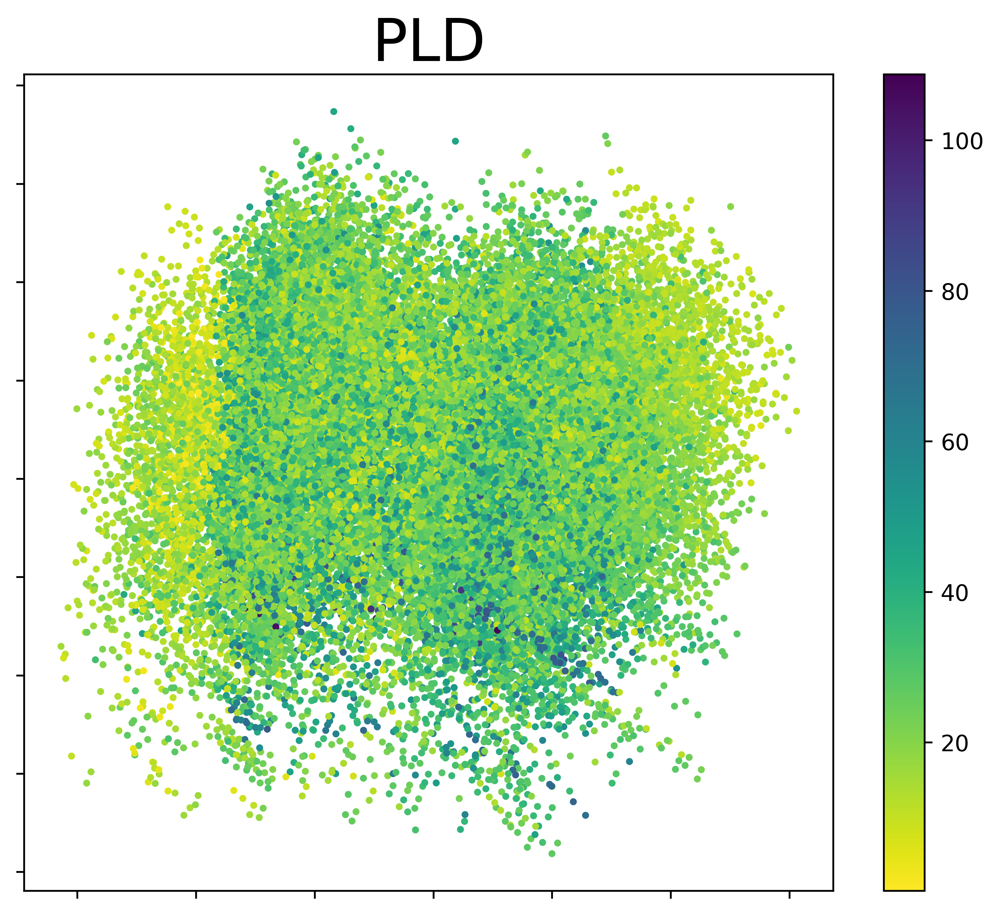

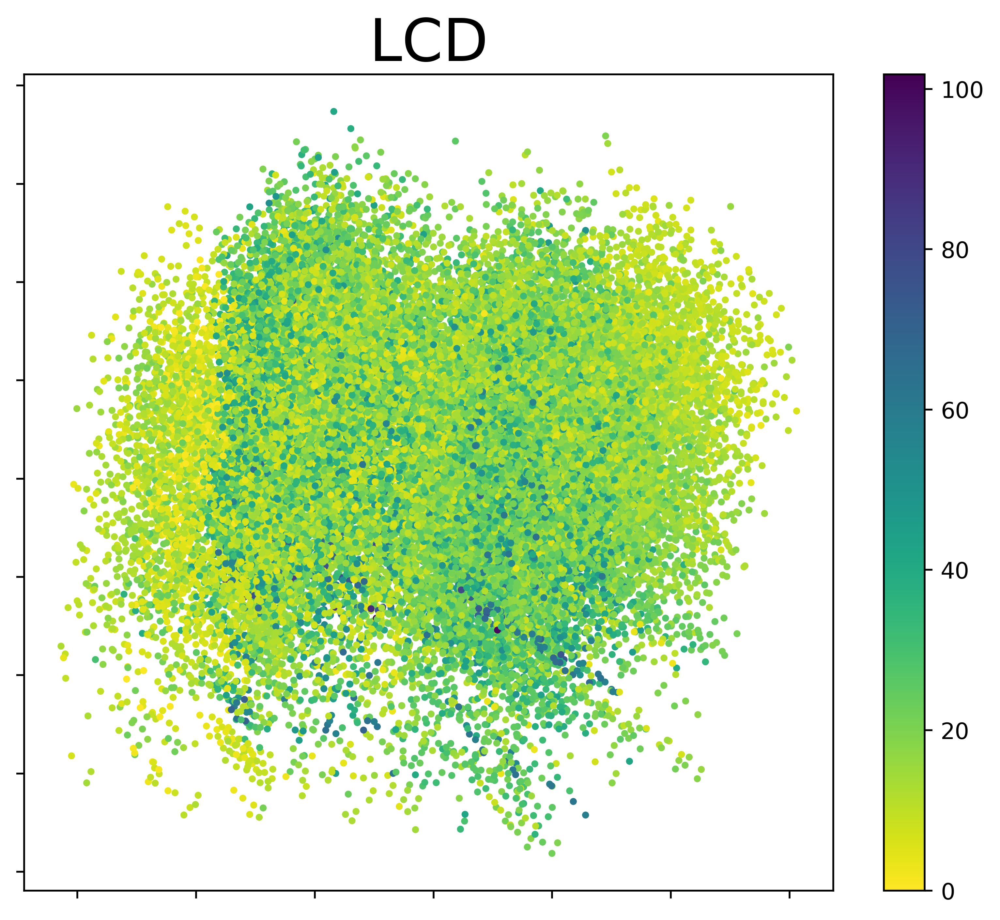

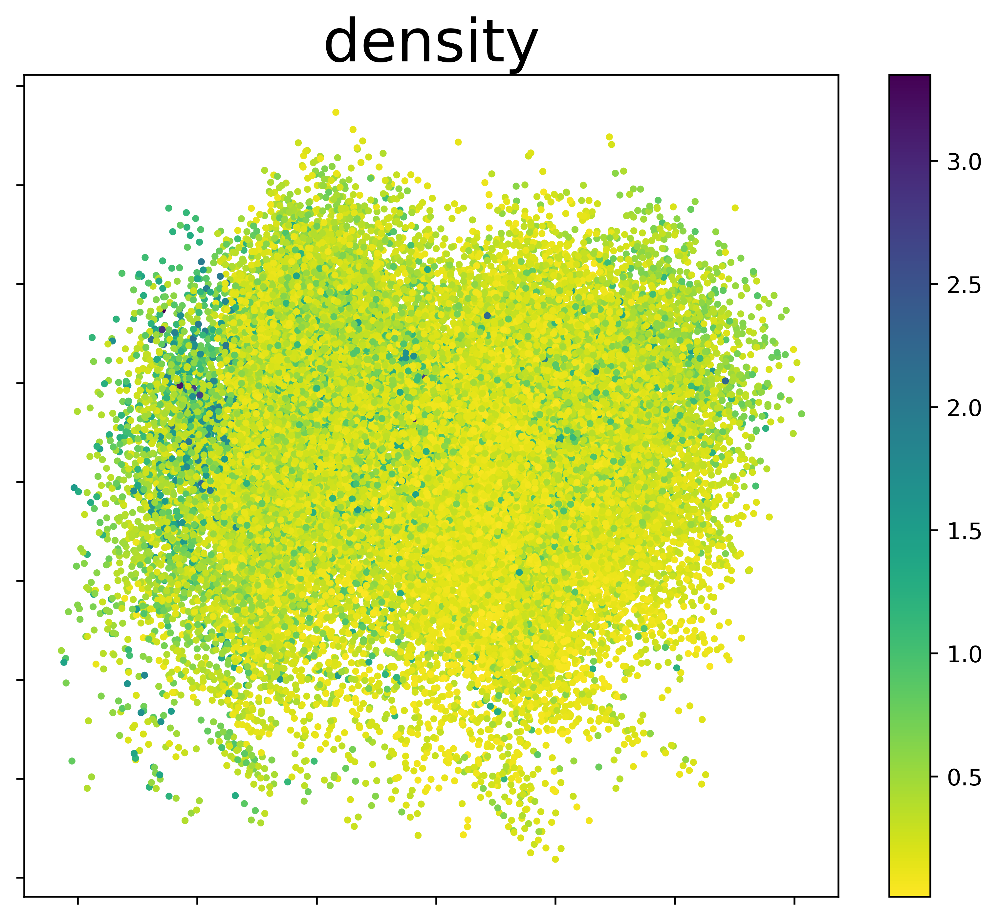

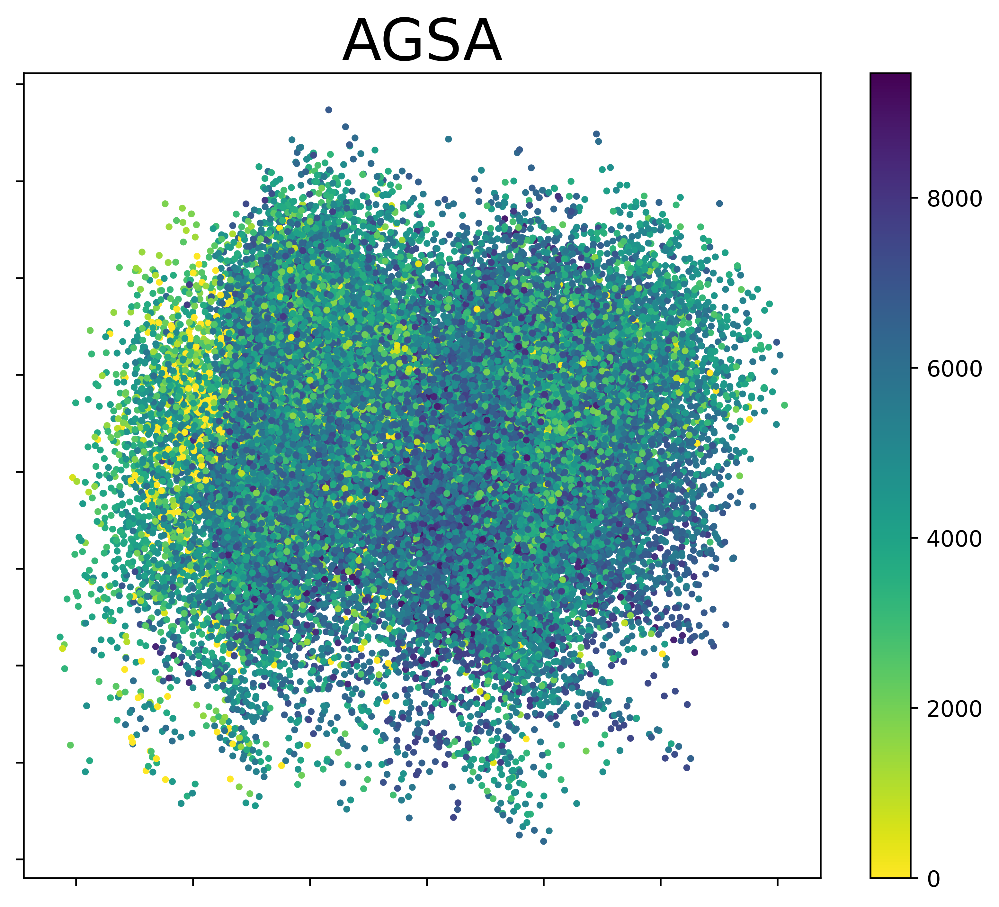

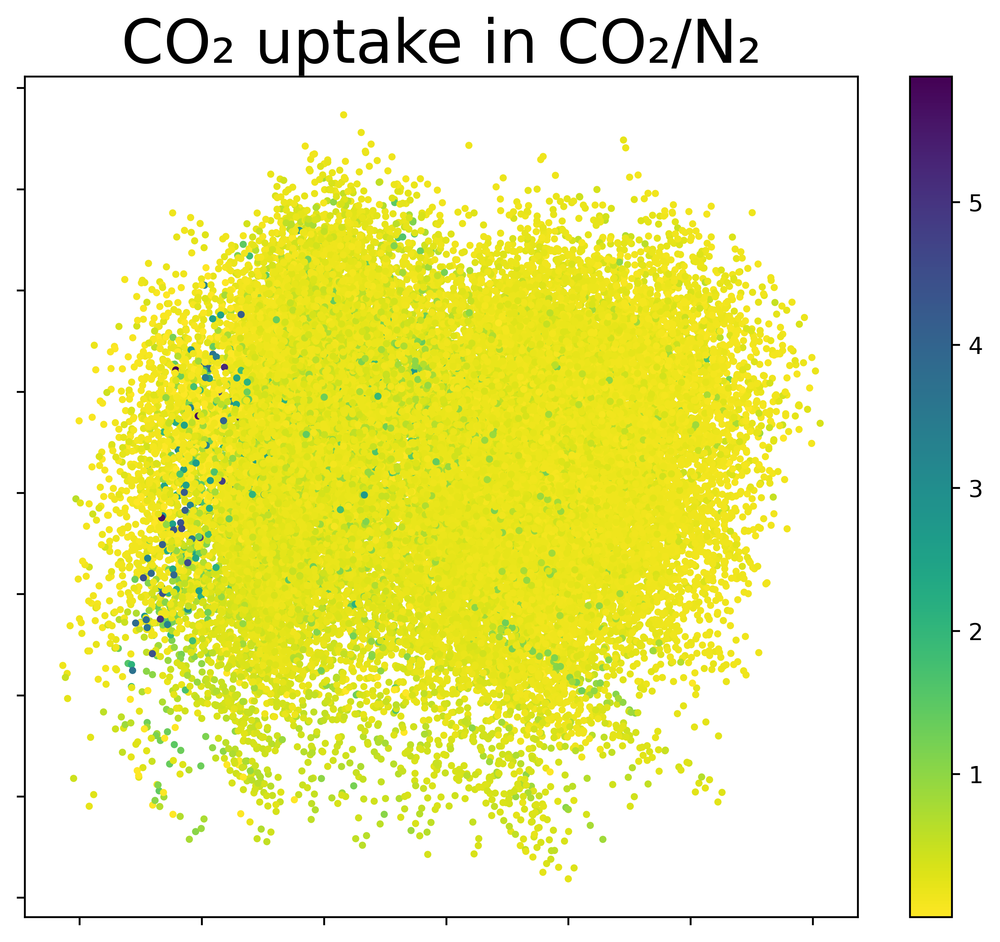

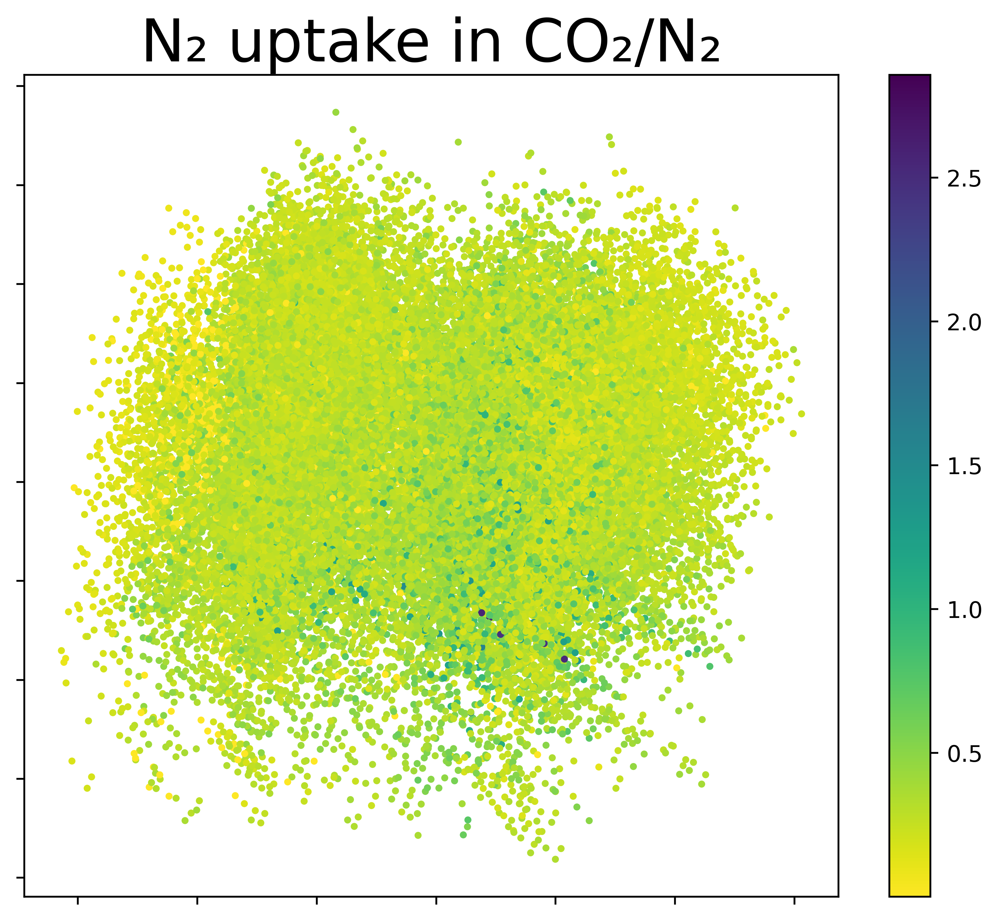

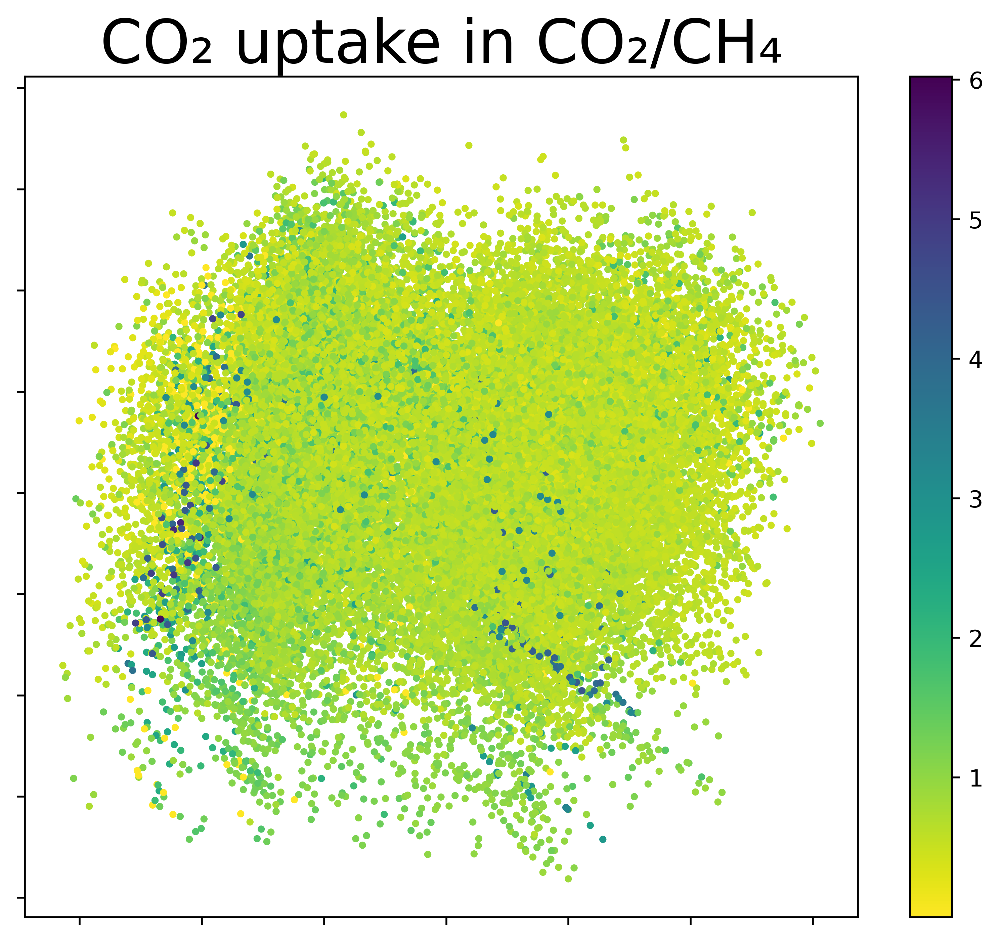

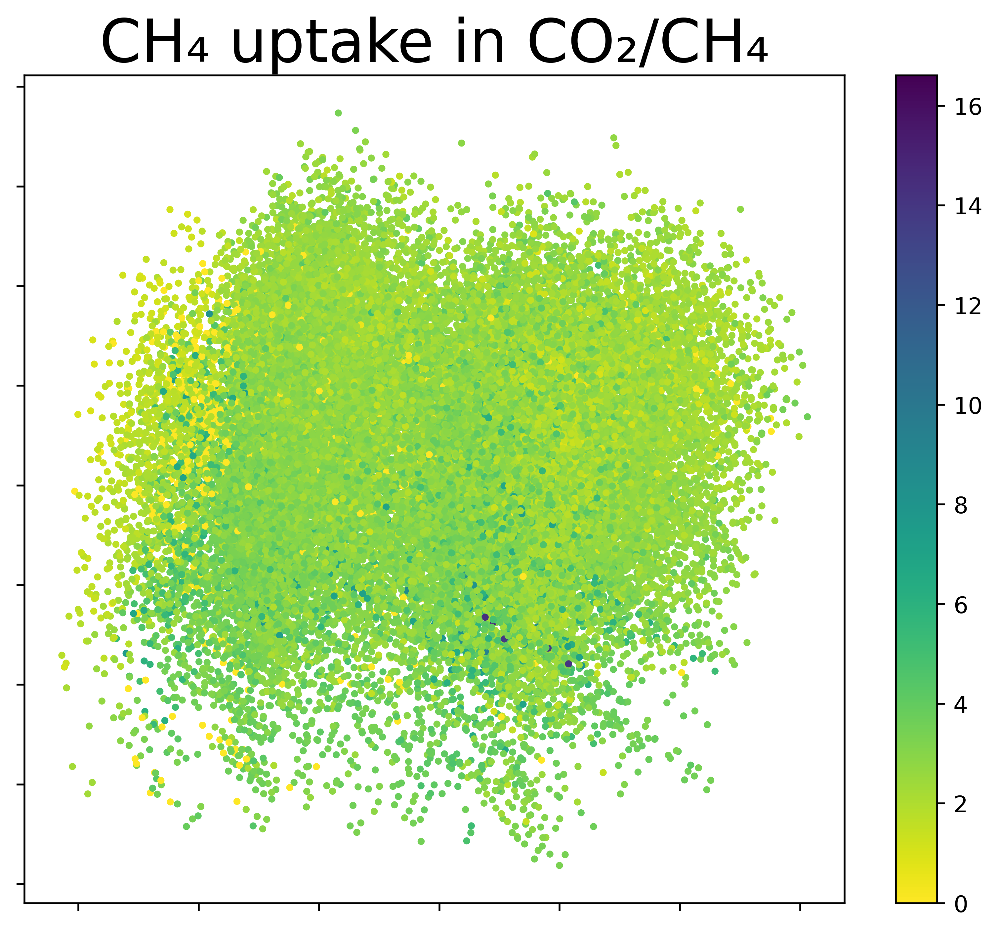

In [18]:
U, S, V = torch.pca_lowrank(z,  q=2)
data_pca = torch.matmul(z.cpu(), V)
for index, y_label in enumerate(img_title):
    utils.pca_image(data_pca, y, index, y_label)

R2 of the Validation Set

In [12]:
y_true = OrderedDict()
y_pred = OrderedDict()
for i in range(len(config['col_y'])):
    y_true[i] = []
    y_pred[i] = []
for batch in tqdm(test_dataset):
    root_vecs, tree_vecs, mol_batch = utils.get_vecs(model, batch, device)
    outputs = model_y.z_to_y(root_vecs, tree_vecs)
    y_true_scaler = model_y.scaler.inverse_transform(mol_batch['y'].cpu().numpy())
    for i in range(len(config['col_y'])):
        y_true[i].extend(y_true_scaler[:, i].reshape(-1))
        y_pred[i].extend(outputs[:, i].reshape(-1))
r2_results = utils.regression_statistics(y_true, y_pred, config['col_y'])

  0%|          | 0/1000 [00:00<?, ?it/s]

lcd : R2 =  0.9327713575806105 , MAE =  1.948202878777844 , RMSE =  3.4762925575401815
pld : R2 =  0.9200789711651379 , MAE =  1.890875222333203 , RMSE =  3.453449444781866
density : R2 =  0.9236275873036199 , MAE =  0.04298365052407993 , RMSE =  0.07791523372779877
agsa : R2 =  0.9233668961952376 , MAE =  277.1836448954792 , RMSE =  490.9680354836396
co2n2_co2_mol_kg : R2 =  0.6889787930262539 , MAE =  0.0600381998311341 , RMSE =  0.1427429614663104
co2n2_n2_mol_kg : R2 =  0.9369219619607987 , MAE =  0.022570428108100858 , RMSE =  0.03944575306389582
co2ch4_co2_mol_kg : R2 =  0.6773096899456342 , MAE =  0.12235995842685264 , RMSE =  0.24950731381897925
co2ch4_ch4_mol_kg : R2 =  0.8604260490546978 , MAE =  0.20409759199605784 , RMSE =  0.3454768902640605


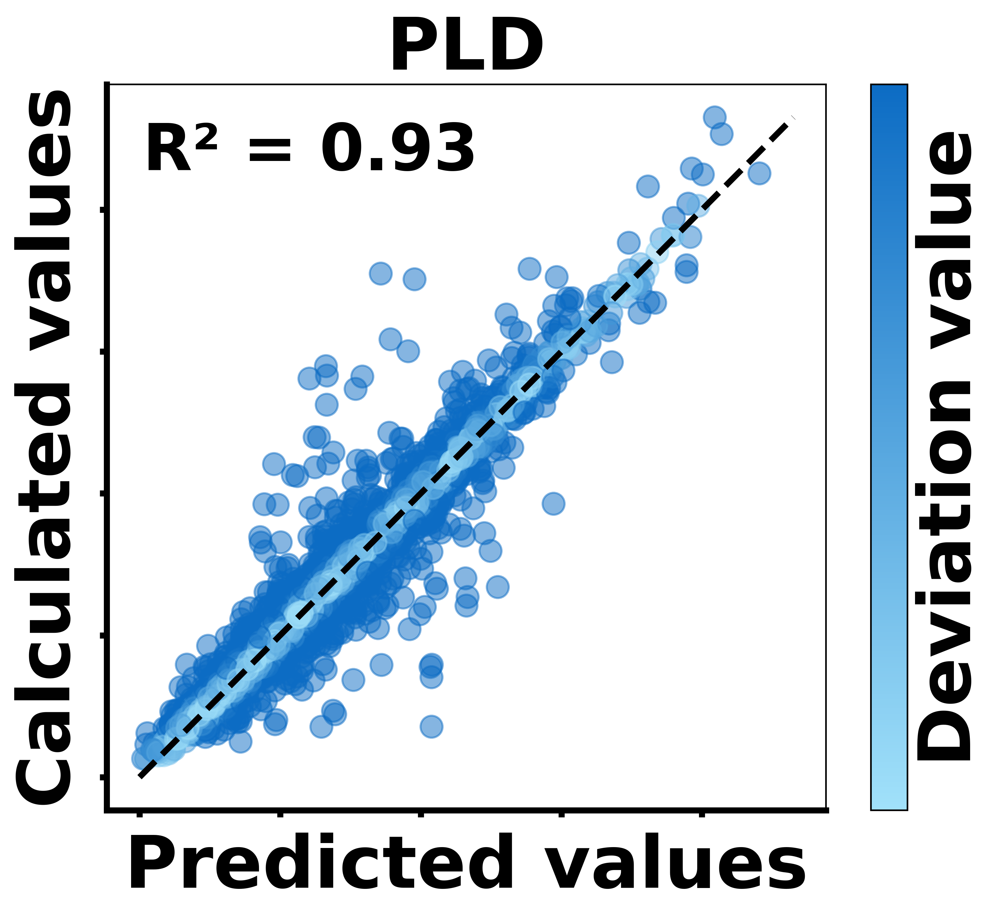

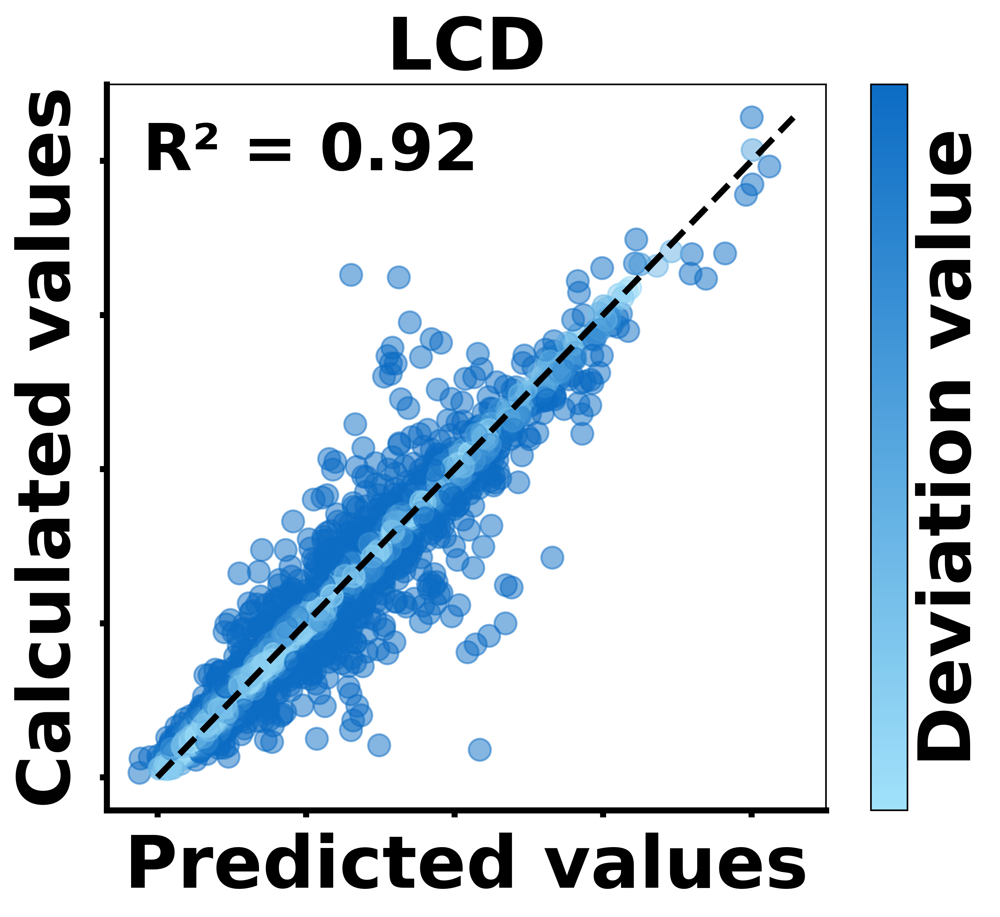

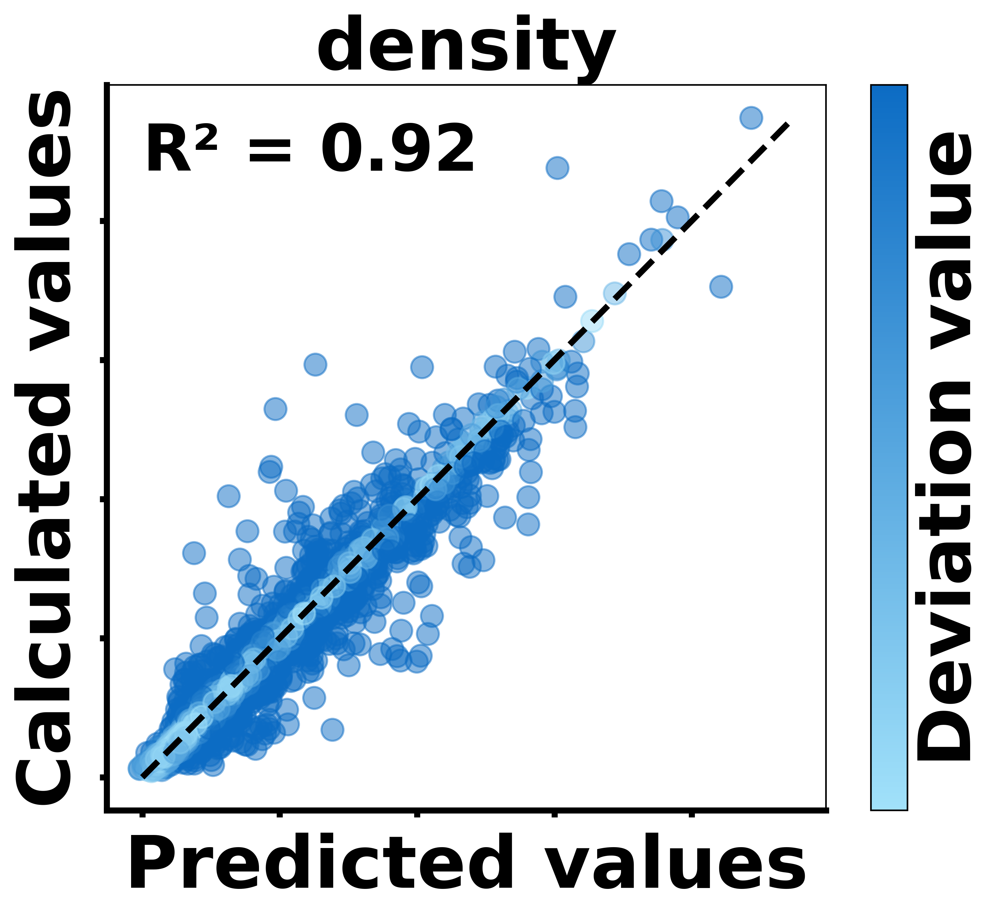

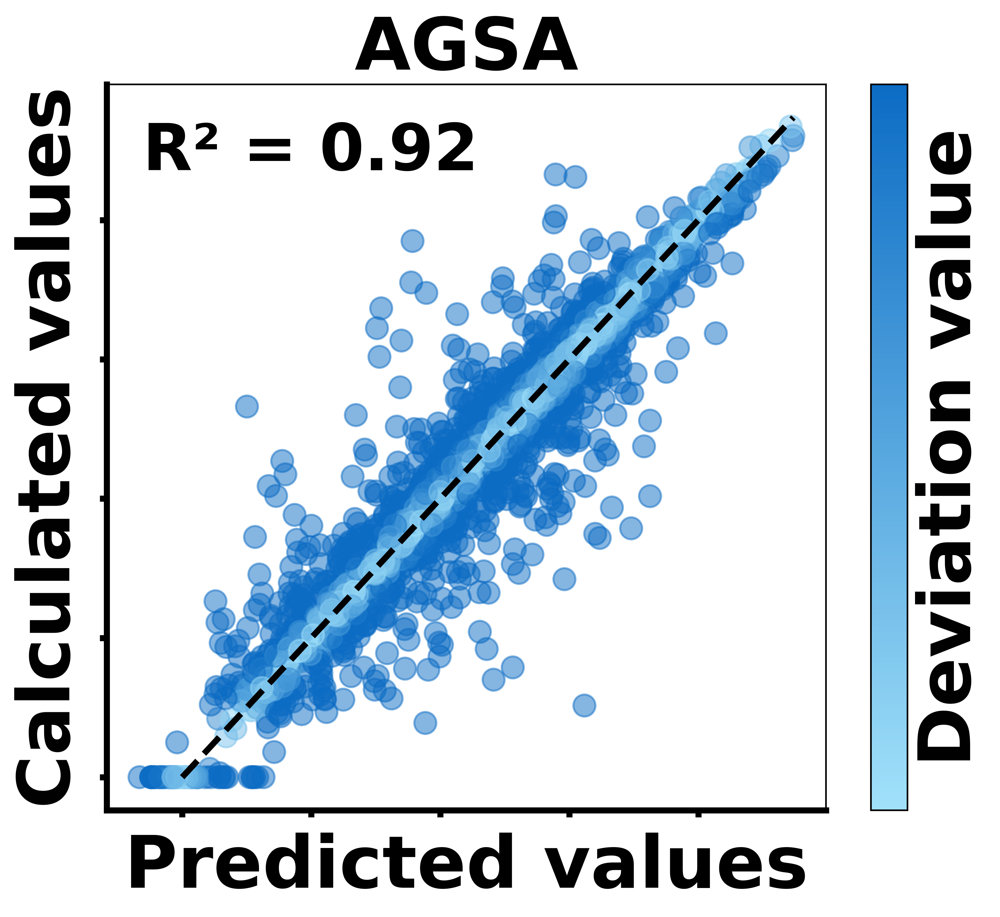

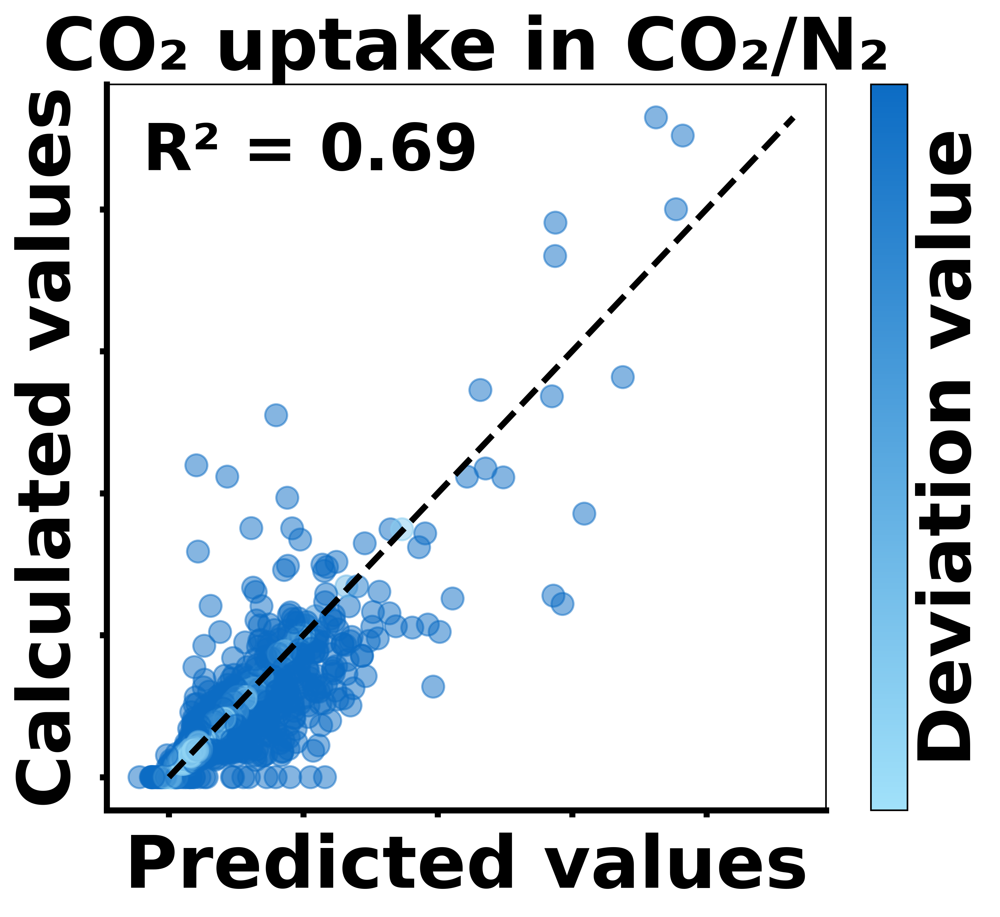

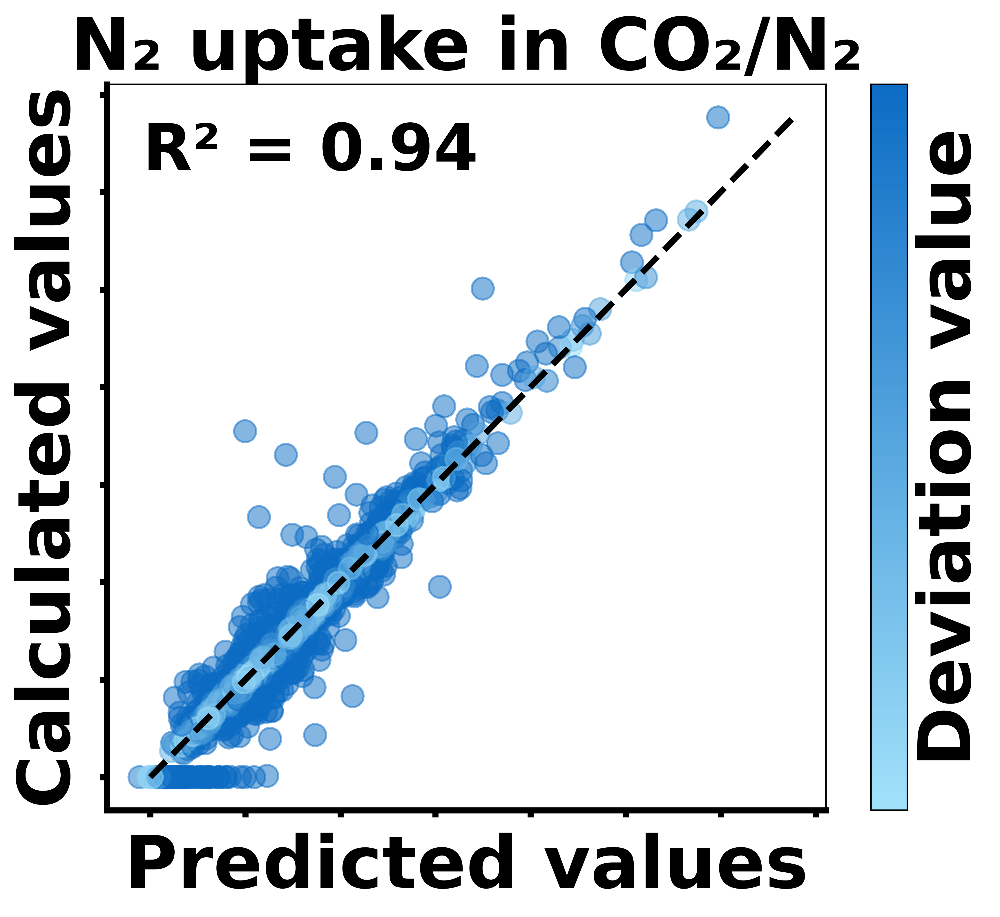

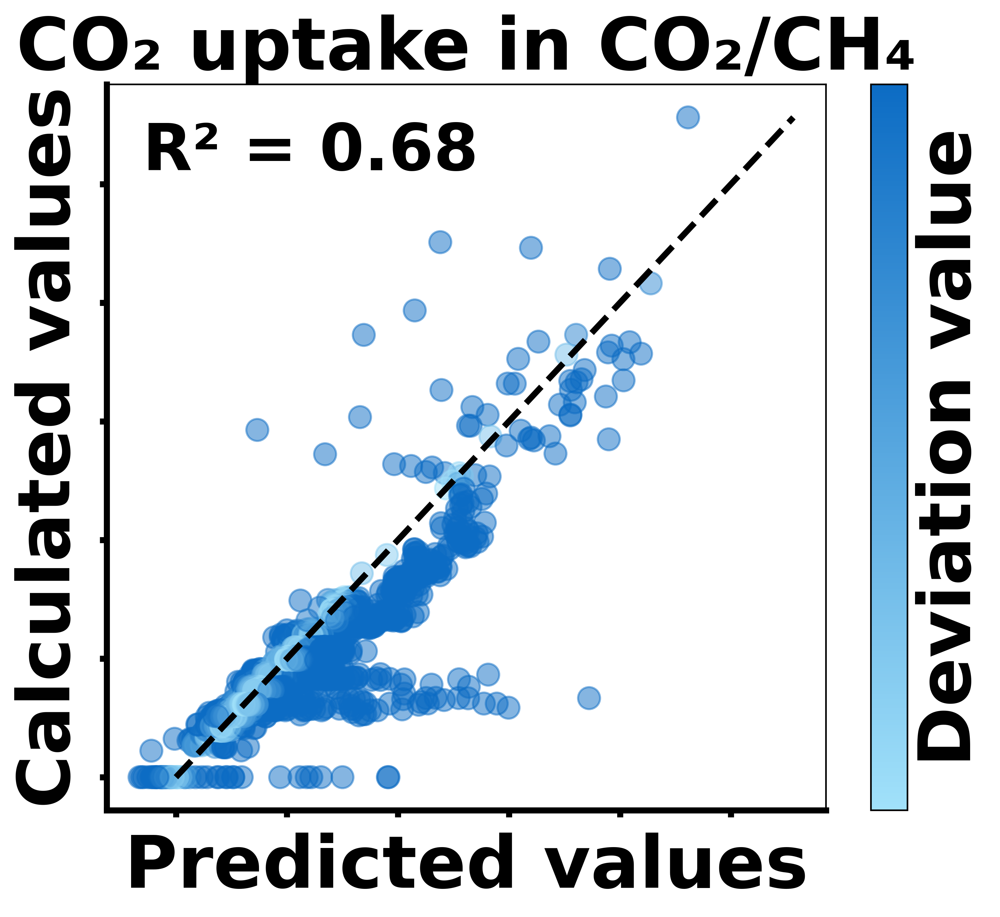

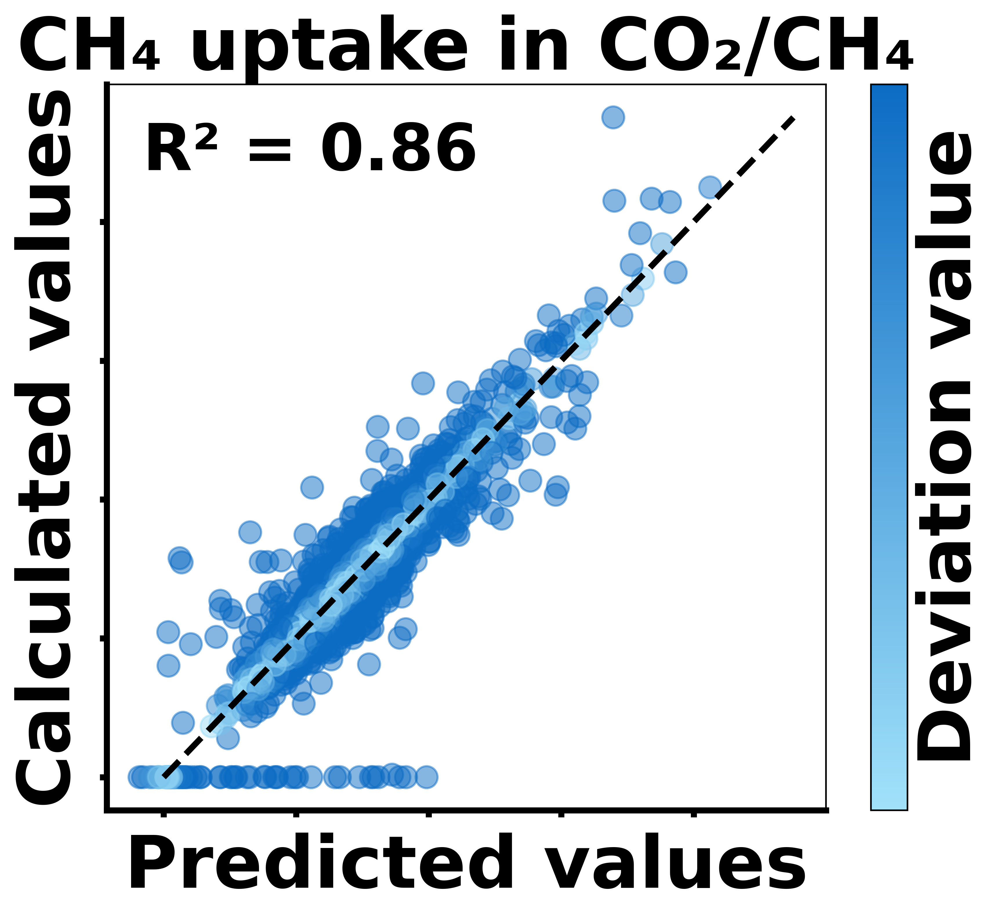

In [17]:
for index, r2_title_value in enumerate(img_title):
    r2 = r2_results['R2'][index]
    y_true_values = y_true[index]
    y_pred_values = y_pred[index]
    plt = utils.plot_scatter_with_deviation(y_true_values, y_pred_values, r2, r2_title_value)
    plt.show()

Find Candidates

In [14]:
start_mof = [('None', 'sym_6_mc_3', 'pcu', '[Lr]c1ccc(cc1)[Lr]')]

if not os.path.exists(config['x_max']) or not config['x_min']:
    model = inference_model.model
    train_dataset = DataFolder(config['tensors_train_prop'], config['train_batch_size'])
    z = []
    x_max = []
    x_min = []
    with torch.no_grad():
        for batch in tqdm(train_dataset):
            root_vecs, _, _ = utils.get_vecs(model, batch, device)
            z.extend(root_vecs.cpu().numpy())
    z = np.stack(z)
    for index in range(z.shape[1]):
        x_max.append(np.max(z[:, index]))
        x_min.append(np.min(z[:, index]))
    np.save(config['x_max'], x_max)
    np.save(config['x_min'], x_min)
else:
    x_max = np.load(config['x_max'])
    x_min = np.load(config['x_min'])

opt_config_dict = dict(configs.opt_config())
print("optimizer config: ")
print(json.dumps(opt_config_dict, indent=4))

optimizer config: 
{
    "opt_num_part": 10,
    "opt_num_swarms": 1,
    "opt_iterations_num": 20,
    "opt_num_track": 10,
    "opt_fitness_name": "co2n2_co2_mol_kg",
    "opt_col": [
        "fitness",
        "branch_smiles",
        "metal_node",
        "organic_core",
        "topology",
        "lcd",
        "pld",
        "density",
        "agsa",
        "co2n2_co2_mol_kg",
        "co2n2_n2_mol_kg",
        "co2ch4_co2_mol_kg",
        "co2ch4_ch4_mol_kg"
    ],
    "x_min": "results/z_max_min/x_min.npy",
    "x_max": "results/z_max_min/x_max.npy",
    "v_min": -0.4,
    "v_max": 0.4
}


In [15]:
opt = BasePSOptimizer.from_query(
        init_building_list=start_mof,
        num_part=config['opt_num_part'],
        num_swarms=config['opt_num_swarms'],
        inference_model=inference_model,
        fitness_name=config['opt_fitness_name'],
        opt_col=config['opt_col'],
        x_min=x_min,
        x_max=x_max,
        v_min=config['v_min'],
        v_max=config['v_max'],
)
opt.run(config['opt_iterations_num'], num_track=config['opt_num_track'])
display(opt.step_fitness_history)

,step,max_fitness,min_fitness,mean_fitness
0,0,0.310951,0.310951,0.310951
0,1,1.208078,0.310951,0.472809
0,2,1.445133,0.310951,0.937615
0,3,1.445133,0.578237,1.129810
0,4,3.321774,1.029748,1.417265
0,5,3.321774,1.059207,1.589247
0,6,3.321774,1.059207,1.589247
0,7,3.321774,1.189420,1.736857
0,8,3.321774,1.189420,1.736857
0,9,3.321774,1.189420,1.754849


In [16]:
display(opt.best_step_mof_history)

,fitness,organic_core,metal_node,topology,branch_smiles,lcd,pld,density,agsa,co2n2_co2_mol_kg,co2n2_n2_mol_kg,co2ch4_co2_mol_kg,co2ch4_ch4_mol_kg
0,0.310952,None,sym_6_mc_3,pcu,[Lr]c1ccc(cc1)[Lr],10.359832,6.173549,1.095152,1551.449097,0.310952,0.173894,2.665196,2.847991
1,0.310951,None,sym_6_mc_3,pcu,[Lr]c1ccc([Lr])cc1,10.359832,6.173549,1.095152,1551.448853,0.310951,0.173894,2.665196,2.847991
2,1.208078,None,sym_6_mc_3,bcs,[Lr]c1ccc([Lr])cc1,10.471687,8.524778,1.223590,1392.744995,1.208078,0.265212,2.419255,4.046994
3,1.445133,None,sym_6_mc_3,bcs,[Lr]c1ccc([Lr])c2ccccc12,8.450154,7.559001,1.301433,1721.104126,1.445133,0.282501,2.376015,4.397906
4,1.351023,None,sym_6_mc_3,bcs,Cc1cc([Lr])ccc1-c1ccc([Lr])cc1C#N,12.195616,9.776231,0.700640,3469.328369,1.351023,0.272349,1.602879,3.143919
5,3.321774,sym_16_mc_6,sym_6_mc_3,bcs,Cc1cc([Lr])ccc1-c1ccc([Lr])cc1-c1ccccc1,17.344393,7.215226,0.727849,2667.038330,3.321774,0.269863,2.692400,3.308617
6,2.749573,sym_16_mc_6,sym_6_mc_3,bcs,Cc1cc([Lr])ccc1-c1ccc([Lr])cc1-c1ccccc1,17.260283,7.288726,0.714599,2637.936279,2.749573,0.276306,2.375788,3.430923
7,0.899782,None,sym_6_mc_3,bcs,[Lr]c1ccc([Lr])cc1,10.478231,8.765443,1.124984,2327.756104,0.899782,0.256401,1.676776,2.841089
8,2.473598,sym_16_mc_6,sym_6_mc_3,bcs,Cc1cc([Lr])ccc1-c1cc([Lr])ccc1-c1ccccc1,12.673195,6.394229,0.811850,1773.364380,2.473598,0.253195,2.481266,3.927398
9,0.251554,None,sym_6_mc_3,bcs,Cc1cc([Lr])ccc1-c1ccc([Lr])cc1C#N,14.963582,10.227584,0.640348,3295.496338,0.251554,0.256815,0.809406,2.749966
